# Final project for HDEq Skills: 
`Due: Friday 3rd December at midnight`

## Instruction and marking scheme

Your submission (like your assignments) will be a Jupyter Notebook (.ipynb file) and a pdf file.  For your analysis and discussion use Markdown cells instead of comments in the code. Use comments to make your scripts easier to follow and understand.

This assignment contributes 12% of the course mark. It will be marked out of 30, comprising the following:
<br>
**Part 1: 18 marks
<br>
Part 2: 12 marks**
<br>

You are welcome to use previous lab/assignment material.

For the presentation and coding style:
- The plots should be in a good size, properly labelled and markers/lines wisely chosen. It might not be a bad idea to combine some plots and put several curves together for easier comparison and conciseness. 
- Your code should be well commented with meaningful variable names and good structures. You don't need to over comment it though!
- The writing should be clear and concise with minimal language or typing mistakes.


It is important that you think about good academic practice when you construct your answers. The work you submit must reflect **your own understanding**, in line with the School's policy on academic misconduct: https://edin.ac/2LtVQMw. Any form of plagiarism that is detected by the software or markers will be reported to the school for the due process.

## Part 1: Wave equation with linear damping

Consider the following wave equation that includes a damping term

<br>
\begin{equation}
u_{tt} + \nu u_{t} = c^2 u_{xx}
\end{equation}
<br>
with the boundary conditions
\begin{equation}
u\left(x = 0, t\right) = 0 , \quad u\left(x = L, t\right) = 0,
\end{equation}
and the initial conditions
\begin{equation*}
u\left(x, t=0\right) = f(x) = \exp\left(\sin^2\left(\frac{2\pi x}{L}\right)\right)-1 , \quad u_t\left(x, t=0\right) = 0,
\end{equation*}

For this problem, let's set $L=10$, $\nu = 0.1$ and $c = 1$.

We use a method to solve this PDE that is known as "Galerkin". In so doing, we approximate the solution with

\begin{equation*}
u(x, t) \approx \sum_{n=1}^{N} f_n(t) \sin(\lambda_n x) 
\end{equation*}

and then derive an appropriate ODE for $f_n(t)$ to solve numerically. This is a form of separation of variables in which the equations for the functions of time are solved numerically rather than by hand. It can be shown that when $N \to \infty$ the above series converges to the exact solution. 

🚩 **Task 1.1 (1 mark)** Considering the above form of solution, find $\lambda_n$ in terms of $n$ and $L$. 

🚩 **Task 1.2 (1 mark)** Using the assumed form of solution and PDE, find an ODE that describes the evolution of $f_n(t)$ in time, (where $n = 1, 2, \dots, N $).

🚩 **Task 1.3 (2 marks)** Using the initial conditions of the PDE and your knowledge of Fourier series, find two initial conditions for $f_n$ and $\cfrac{df_n}{dt}$ at $t=0$. Your answer in this part might in the form of an integral, which you should not evaluate at this point (we will calculate this integral later numerically).


\begin{equation*}
u(x, t) \approx \sum_{n=1}^{N} f_n(t) \sin(\lambda_n x) 
\end{equation*}

first, we require $\lambda_n = \frac{n\pi}{L}$, so:

\begin{equation*}
u(0, t) = u(L, t) = 0
\end{equation*}

Using our other initial condition we have:

\begin{equation*}
    u(x, 0) = \sum_{n=1}^{N} f_n(0) \sin(\lambda_n x) = f(x)
\end{equation*}


\begin{equation*}
    u_t(x, 0) = \sum_{n=1}^{N} f_n'(0) \sin(\lambda_n x) = 0
\end{equation*}


so:

\begin{equation*}
f_n(0) <\sin(\lambda_n x), \sin(\lambda_n x)> \; = \; f_n(0) L \; = \; <f(x), \sin(\lambda_n x)>
\quad \text{and} \quad
f_n'(0) = 0
\end{equation*}


We have:

\begin{equation*}
u_{xx} \approx - \sum_{n=1}^{N}f_n(t) \lambda_n^2 \sin(\lambda_n x) 
\qquad
u_{tt} \approx \sum_{n=1}^{N}f_n''(t) \sin(\lambda_n x) 
\qquad
u_{t} \approx \sum_{n=1}^{N} f_n'(t) \sin(\lambda_n x) 
\end{equation*}

so:


\begin{equation*}
0 = u_{tt} + \nu u_{t} - c^2 u_{xx} \approx \sum_{n=1}^{N} (f_n''(t) + \nu f_n'(t) + (c \lambda_n)^2 f_n(t)) \sin(\lambda_n x) 
\end{equation*}

so:

\begin{equation*}
f_n''(t) + \nu f_n'(t) + (c \lambda_n)^2 f_n(t) = 0 
\qquad 
f_n(0) = \frac{1}{L}<f(x), \sin(\lambda_n x)> 
\qquad
f_n'(0) = 0
\end{equation*}

note we continue $f$ for (x < 0) so that it is an odd function, so:

\begin{equation*}
<f(x), \sin(\lambda_n x)> \; = \; 2 \int_{0}^L f(x)\sin(\lambda_n x) dx
\end{equation*}


🚩 **Task 1.4 (3 marks)** Write a function that takes $n$ (the index of the terms in the series solution, for example $n=3$ corresponds to $f_3(0)$) as an input and returns $f_n(0)$. You might solve this part using different tools: 1) `sympy` module or 2) direct numerical calculation using  `scipy.integrate` (see the documentation [here](https://docs.scipy.org/doc/scipy/reference/tutorial/integrate.html)). Make sure your final result is a numerical real value (not symbolic expressions). Remember from your labs that you can use `.N()` method to evaluate a sympy expression (if you decide to use `sympy`, which is not the only way to complete this task).

Once you have written your function, use it to calculate $f_n(0)$ for $L=10$, $n=5$ and the given initial condition $u(x, t=0) = \exp\left(\sin^2\left(\frac{2\pi x}{L}\right)\right)-1$.

In [47]:
import sympy as sym
import numpy as np
import scipy.integrate as int

L = 10

def f(x):
    return np.exp(np.sin(2*np.pi*x/L)**2)-1

def calc_fn_0(k):
    integral, max_error = int.quad(
        lambda x: f(x)*np.sin(k*np.pi*x/L),
        0, L 
    )
    return 2*integral/L

print(calc_fn_0(5))

0.7767162985319099


🚩 **Task 1.5 (4 marks)** Write a function to solve the ODEs that you derived in 'Task 1.2' for each $f_n(t)$. Your function takes $n$ (the index of terms in the solution series) and `t_vec` (the vector of times at which you want to have the solution). Then, it calculates the corresponding initial conditions ($f_n$ and $\cfrac{df}{dt}$ at $t=0$), solves the associated ODE and returns the solution at each point in `t_vec`. Use `odeint` to solve the ODE numerically. You may also use the function you wrote in the previous task.

Use the function to plot $f_1(t)$, $f_2(t)$ and $f_3(t)$ for `t_vec = np.linspace(0, 100, 1001)`.

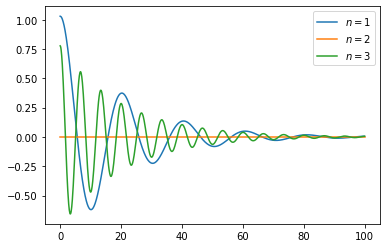

In [100]:
import matplotlib.pyplot as plt
from scipy.integrate import odeint
# and this is the line in case the figure does not show up!
%matplotlib inline

nu = .1
c = 1
L = 10

def dF_dt(F, t, k):
    '''
    this function defines the RHS of the system of ODEs for f_n's
    ----------------------------------------------------
    '''
    f, fp = F
    # f_n''(t) = - nu f_n'(t) - (c lambda_n)^2 f_n(t) 
    fpp = -fp*nu - f*(c * k*np.pi/L)**2
    return fp, fpp
    
def fn_solve(k, t_vec):
    '''
    This function derives the solution of f_k(t) for all the times in 't_vec'
    'k' is given as an input and marks the index of the term in series solution 
    '''
    fn_0 = calc_fn_0(k)
    solution = odeint(dF_dt, (fn_0, 0), t_vec, args=(k,))
    f_t, fp_t = solution.T
    return f_t
    

t_vec = np.linspace(0, 100, 1001)

for n in range(1, 4):
    plt.plot(t_vec, fn_solve(n, t_vec), label=f"$n = {n}$")

plt.legend()
    

🚩 **Task 1.6 (4 marks)** Write a function that takes $N$ (the total number of terms in the sine series of the solution), `t_vec` and `x_vec` (which is the vector of points in space) as inputs and returns the solution $u(x,t)$ of the PDE at the times `t_vec` and points `x_vec`. Your function output should be a $N_T \times N_X$ numpy array, where $N_T$ is the number of points in time (i.e. the size of `t_vec`) and  $N_X$ is the number of points in space (i.e. the size of `x_vec`). Make good use of the functions you already wrote in the previous tasks.

With this function, find the solution for 

`x_vec = np.linspace(0, L, 201)`

`t_vec = np.linspace(0, 100, 1001)` 

`N =7`

Make an animation to show how $u(x,t)$ changes in time (each frame of animation is the solution at all spatial points but for one specific point in time)

In [114]:
def waveq_dam_solve(N, t_vec, x_vec):
    return sum(
        np.outer(fn_solve(n, t_vec), np.sin(n*np.pi*x_vec/L)) for n in range(1, N+1)
    )


x_vec = np.linspace(0, L, 201)
t_vec = np.linspace(0, 100, 1001)

sin_matrix = np.array([
    np.sin(n*np.pi*x_vec/L) for n in range(1, 8)
])


f_matrix = np.array([
    fn_solve(n, t_vec) for n in range(1, 8)
])

u_x_t = f_matrix.T @ sin_matrix



print(sin_matrix.shape)

print(f_matrix.shape)


# u_x_t = waveq_dam_solve(7, t_vec, x_vec)

(7, 201)
(7, 1001)


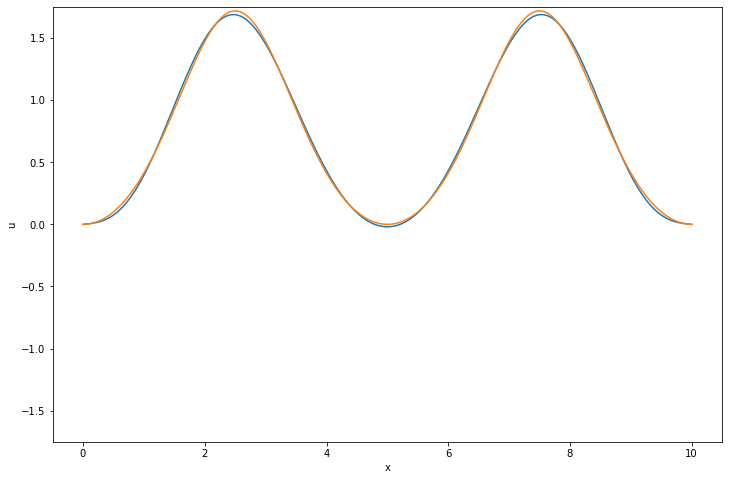

In [121]:
fig, ax = plt.subplots(figsize=(12, 8))

ax.set_xlabel('x')
ax.set_ylabel('u')
ax.set_ylim(-1.75, 1.75)

# Assuming the PDE's solution is stored in u_x_t[:,:],
# compare the approx. solution at t=0 with the initial condition

line, = ax.plot(x_vec, u_x_t[0,:])
ax.plot(x_vec, np.exp((np.sin(2*np.pi*x_vec/L))**2)-1)

In [88]:
import matplotlib.animation as animation
from IPython.display import HTML

txt = ax.text(0, 0.9, 't=0')

def init():
    line.set_ydata(u_x_t[0,:])
    return line,

def animate(i):
    line.set_ydata(u_x_t[i,:])  # update the data
    txt.set_text(f't={round(t_vec[i], 2)}') # update the annotation
    return line, txt

ani = animation.FuncAnimation(fig, animate, len(t_vec)-1, init_func=init,
                              interval=100, blit=True)

HTML(ani.to_jshtml())

Animation size has reached 20988700 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


🚩 **Task 1.7 (2 marks)** Examine how the solution changes for different values of $N$. Consider $N=3$, $N=7$ and $N=11$. Show the animation of the solution for all the three cases in one plot and compare them with each other. Discuss and analyse your results (for example, are three terms enough to get an acceptable solution? What about seven?)

In [95]:
N_vals = [3, 7, 11]

u_x_t_sols  = [
    waveq_dam_solve(N, t_vec, x_vec) for N in N_vals
]

fig, ax = plt.subplots(figsize=(12, 8))

ax.set_xlabel('x')
ax.set_ylabel('u')
ax.set_ylim(-1.75, 1.75)

u_x_t_sols = []
lines = []

for N in N_vals:
    u_x_t = waveq_dam_solve(N, t_vec, x_vec)
    u_x_t_sols.append(u_x_t)
    line, = ax.plot(x_vec, u_x_t[0,:], label=f"N = {N}")
    lines.append(line)

plt.legend()
plt.close()

txt = ax.text(0, 0.9, 't=0')

def init():
    for line, u_x_t in zip(lines, u_x_t_sols):
        line.set_ydata(u_x_t[0,:])
    return lines

def animate(i):
    for line, u_x_t in zip(lines, u_x_t_sols):
        line.set_ydata(u_x_t[i,:])  # update the data
    txt.set_text(f't={round(t_vec[i], 2)}') # update the annotation
    return [*lines, txt]

ani = animation.FuncAnimation(fig, animate, len(t_vec)-1, init_func=init,
                              interval=100, blit=True)

HTML(ani.to_jshtml())

Animation size has reached 20984116 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


🚩 **Task 1.8 (1 marks)** Change the damping parameter to $\nu = 1$, and repeat the 'task 1.6' (for $N=7$ and keep all other parameters the same). In few sentences, explain the changes caused by increasing the damping.

## Part 2: Lorenz system


The Lorenz system is given by the coupled set of ODEs
\begin{equation}
  \frac{\mathrm{d}x}{\mathrm{d}t} = -\sigma x + \sigma y, \qquad
  \frac{\mathrm{d}y}{\mathrm{d}t} = x(\rho - z) - y, \qquad
  \frac{\mathrm{d}z}{\mathrm{d}t} = xy - \beta z,
\end{equation}
where ($\rho, \sigma, \beta$) are system parameters. Lorenz derived these equation as a simplified mathematical model for [atmospheric convection](https://en.wikipedia.org/wiki/Atmospheric_convection), which is an aspect of weather.  While the Lorenz system is deterministic, you will find in this problem that in certain sets of parameters there is sensitive dependence of the solution on the initial condition. Assuming this system is a representation of weather, small errors invariably arise (e.g. numerical discretisation, measurements inaccuracy), grow and affect long term solutions (cf. loss of predictability in weather forecasting). However, there are statistical properties (cf. the climatology) that may be robust and may be described accordingly.

--------------------
### Case of stable solution


Consider the parameters $\sigma = 8$, $\beta = 2$ and $\rho = 12$.


🚩 **Task 2.1 (1 mark)** Find all the critical points of this system.

🚩 **Task 2.2 (2 marks)** Using a numerical method of your choice, find the solution starting from $x(t=0) = y(t=0) = z(t=0) = 10$ up to $t=20$. Plot the solution in *x-y*, *y-z* and *x-z* planes (so you need three plots). Where does this initial condition end up in? Can you express the exact location of this solution as $t \to \infty$? Make sure your timestep is small enough to have robust results. You can check this by running your code for several different timesteps.

In [150]:
# Task 2.2
import numpy as np
import sympy as sym
from scipy.integrate import odeint
import matplotlib.pyplot as plt
from itertools import combinations


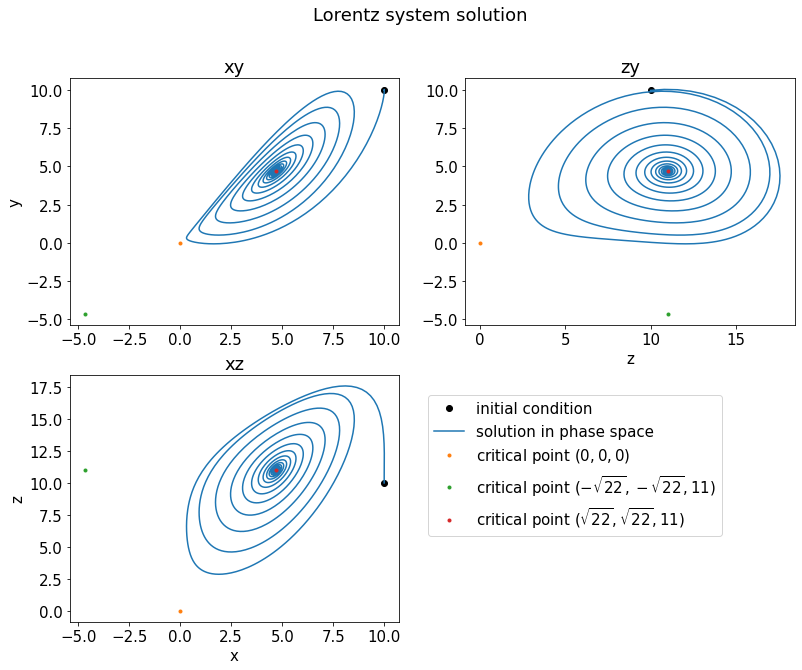

In [166]:

# Set the global fontsize for matplotlib plots so that they are and more readable
plt.rcParams.update({'font.size': 15})


sigma = 8
beta = 2
rho = 12

x, y, z = sym.symbols("x y z")

x_prime = -sigma*x + sigma*y
y_prime = x*(rho - z) - y
z_prime = x*y - beta*z

crit_point_dicts = sym.solve([x_prime, y_prime, z_prime])
# print(crit_point_dicts)

# crit_point_coords = [[] for _ in crit_point_dicts]

# for crit_point_dict in crit_point_dicts:
#     for key, coord_list in zip((x, y, z), crit_point_coords):
#         coord_list.append(crit_point_dict[key])
        
# print(crit_point_coords)

# def func(coords, t):
#     # substitute the given values for x, y and z into the expressions for x', y' and z'
#     return np.array([
#         float(derivative.subs(zip([x, y, z], coords))) for derivative in (x_prime, y_prime, z_prime)
#     ])

def funct(coords, t):
    x_coord, y_coord, z_coord
    return np.array([
        -sigma*x_coord + sigma*y_coord,
        x_coord*(rho - z_coord) - y_coord,
        x_coord*y_coord - beta*z_coord
    ])

initial_condition = (10, 10, 10)

solution = odeint(func, initial_condition, np.linspace(0, 20, 2000))

x_sol, y_sol, z_sol = solution.T

# Create and decorate the figure.
fig = plt.figure(figsize=(13, 10))
fig.suptitle("Lorentz system solution")

# Put the x against y axis in the top left of our subplot.
xy_ax = fig.add_subplot(2, 2, 1)
xy_ax.set_ylabel("y")
xy_ax.set_title("xy")

# Put the y against z axis in the top right of our subplot, sharing a y axis with xy_ax.
zy_ax = fig.add_subplot(2, 2, 2, sharey=xy_ax)
zy_ax.set_xlabel("z")
zy_ax.set_title("zy")

# Put the x against z axis in the bottom right of our subplot, sharing an x axis with xy_ax.
xz_ax = fig.add_subplot(2, 2, 3, sharex=xy_ax)
xz_ax.set_xlabel("x")
xz_ax.set_ylabel("z")
xz_ax.set_title("xz")

plotting_data = {
    var: (var_sol, var_ic) for var, var_sol, var_ic in zip((x, y, z), solution.T, initial_condition)
}

for ax, var_1, var_2 in ((xy_ax, x, y), (zy_ax, z, y), (xz_ax, x, z)):
    sol_1, ic_1 = plotting_data[var_1]
    sol_2, ic_2 = plotting_data[var_2]
    ax.plot([ic_1], [ic_2], "ko", label="initial condition")
    ax.plot(sol_1, sol_2, label="solution in phase space")
    
    for crit_point in crit_point_dicts:
        label = f"critical point $({sym.latex(crit_point[x])}, {sym.latex(crit_point[y])}, {sym.latex(crit_point[z])})$"
        ax.plot([crit_point[var_1]], [crit_point[var_2]], "o", label=label)

        
handles, labels = xy_ax.get_legend_handles_labels()

fig.legend(handles, labels, loc="upper left", bbox_to_anchor=(0.5, 0.0, 1, 0.45))


🚩 **Task 2.3 (4 marks)** Consider two different numerical methods: forward Euler and Ruge-kutta (4th order) methods. Set the initial condition to $x = y = z = 100$ and the final time to 0.3. The Ruge-kutta method with timestep h=10^{-6} is accurate enough that **we can regard it as an exact solution**. Using this *estimate numerically* the **global error** for variable $x$ and plot it in log-scale as a function of timestep. In so doing, consider the values `[0.002, 0.001, .0005, 0.0002, 0.0001]` for timesteps. 

Note that the order of error can be estimated from the slope of plots in log-scales. If a function is proportional to $h^{6}$, then in log-scale it looks linear and have the slope of $6$.

What is the slope of global error vs timestep for each method? Why do you get these slopes? You can estimate the slopes by drawing linear guidelines. For example, if you draw $h^{6}$ and your curve is close to this guideline, then you can conclude that the slope is close to $6$. You need to shift your guidelines up and down to bring them closer to the results of numerical solutions. Are the results different than the slopes you expect for the local error as a function of timestep? Can you reason why?


(Remember that you have already implemented forward Euler and Ruge-kutta in your lab notebooks. There is also something called "copy-paste".)

In [167]:
# forward Euler scheme
def ode_Euler(func, times, y0):
    '''
    integrates the system of y' = func(y, t) using forward Euler method
    for the time steps in times and given initial condition y0
    ----------------------------------------------------------
    inputs:
        func: the RHS function in the system of ODE
        times: the points in time (or the span of independent variable in ODE)
        y0: initial condition (make sure the dimension of y0 and func are the same)
    output:
        y: the solution of ODE. 
        Each row in the solution array y corresponds to a value returned in column vector t
    '''
    times = np.array(times)
    y0 = np.array(y0)
    n = y0.size       # the dimension of ODE 
    nT = times.size   # the number of time steps 
    y = np.zeros([nT,n])
    y[0, :] = y0
    # loop for timesteps
    for k in range(nT-1):
        y[k+1, :] = y[k, :] + (times[k+1]-times[k])*func(y[k, :], times[k])
    return y


# Runge-Kutta 4 scheme
def ode_RK4(func, times, y0):
    '''
    integrates the system of y' = func(y, t) Runge-Kutta using method
    for the time steps in times and given initial condition y0
    ----------------------------------------------------------
    inputs:
        func: the RHS function in the system of ODE
        times: the points in time (or the span of independent variable in ODE)
        y0: initial condition (make sure the dimension of y0 and func are the same)
    output:
        y: the solution of ODE. 
        Each row in the solution array y corresponds to a value returned in column vector t
    '''
    times = np.array(times)
    y0 = np.array(y0)
    n = y0.size       # the dimension of ODE 
    nT = times.size   # the number of time steps 
    y = np.zeros([nT,n])
    y[0, :] = y0
    # loop for timesteps
    for i in range(nT-1):
        dt = times[i+1]-times[i]
        t_i = times[i]
        y_i = y[i, :]
        # Calculate the k_1, k_2, k_3 and k_4
        k_1 = func(y_i, t_i)
        k_2 = func(y_i + 0.5*dt*k_1, t_i + 0.5*dt)
        k_3 = func(y_i + 0.5*dt*k_2, t_i + 0.5*dt)
        k_4 = func(y_i + dt*k_3, t_i + dt)
        # Calculate the next step
        y[i+1, :] = y_i + (1/6)*dt*(k_1 + 2*k_2 + 2*k_3 + k_4)
    return y

initial_condition = (100, 100, 100)
t_start = 0
t_end = 0.3

h = 1e-6
no_points = round((t_end - t_start)/h) + 1
times = np.linspace(t_start, t_end, no_points)
exact_soln = ode_RK4(func, times, initial_condition)

# print(no_points)
# print(np.linspace(t_start, t_end, no_points))

for h in [0.002, 0.001, .0005, 0.0002, 0.0001]:
    print(h)
    no_points = round((t_end - t_start)/h) + 1
    times = np.linspace(t_start, t_end, no_points)
    euler_soln = ode_Euler(func, times, initial_condition)
    RK4_soln = ode_RK4(func, times, initial_condition)
    print(euler_soln[-1])
    print(RK4_soln[-1])
    print()

0.002
[ 33.11705987 110.98473337 137.85705046]
[-10.37991262  69.56923785  60.13203578]

0.001
[  8.39328477 104.76627246  63.72975735]
[-10.37938637  69.56997981  60.13129973]

0.0005
[-1.86029274 88.19303286 57.08314607]
[-10.37936053  69.57000904  60.13125801]

0.0002
[-7.18702306 77.25080006 58.20823072]
[-10.37935909  69.57001036  60.13125545]

0.0001
[-8.81987865 73.45147817 59.08721004]
[-10.37935906  69.57001039  60.13125538]



--------------------
### Case of chaotic behaviour and strange attractor


Consider the set of parameters $\sigma = 8/3$, $\beta = 4$ and $\rho = 6$ and stick to Runge-Kutta scheme with timestep of $h = 10^{-4}$ for this part. 

**Task 2.4 (2 marks)** Draw the three-dimensional phase portraits using $x = y = z = 1$ as initial condition. You can use the script below to plot 3D curves.


**Task 2.5 (3 marks)** Change the initial condition as $x = 1 + \epsilon, y = 1, z = 1$, where $\epsilon$ is $10^{-1}$, $10^{-5}$ and $10^{-12}$. Draw the phase portrait for each initial condition and compare it to what you got for Task 2.4. Do they look different? Representing the outputs of these new solutions (with new initial conditions) with $x_1$, $y_1$ and $z_1$ and the solution starting from $x = y = z = 1$ with $x^*$, $y^*$ and $z^*$, compute a measure of difference between these solutions given by
  
\begin{equation*}
\mathcal{e}(t) = \sqrt{(x^*(t) - x_1(t))^2 +  (y^*(t) - y_1(t))^2 + (z^*(t) - z_1(t))^2}.
\end{equation*}
  
Plot the time-series diagrams of $\mathcal{e}(t)$ for three different values of $\epsilon$. From the behaviour of $\mathcal{e}(t)$ answer the following questions:

- If two initial conditions are very close, do their corresponding trajectories stay close to each other in time? 

- Do you see an upper bound for $\mathcal{e}(t)$? What does this imply?
  
  
*The moral of the story is that the exact realisations (the "weather") can have sensitive dependence on initial conditions, and in reality errors always exist, so loss of accuracy in weather prediction is fairly rapid. However there are gross features that remain roughly invariant and can be described, for example the butterfly attractor that you see in your results (the "climate").*

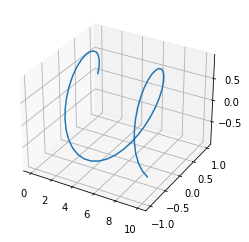

In [124]:
# some hint how to create 3D plots for phase portraits
from mpl_toolkits.mplot3d import Axes3D

x = np.linspace(0, 10)
y = np.cos(x)
z = np.sin(x)




fig = plt.figure()
ax = fig.gca(projection="3d")
ax.plot(x, y, z) # x and y and z are the time series of the solution
plt.draw()
plt.show()